In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
# ***********************************
# Version: 0.1.1                    #
# Author:  rongboshen               #
# Email:   rongboshen2019@gmail.com #
# Date:    2023.10.24               #
# ***********************************

import os
import numpy as np
import pandas as pd
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.io as io
import scanpy as sc
from anndata import AnnData
import json
from scipy.cluster.hierarchy import leaves_list


In [2]:
def horizontal(array, height=0):
    horizonx = array[:,0]
    horizony = height - array[:,1]
    return np.stack((horizonx, horizony),axis=1)

def verizontal(array, width=0):
    verizonx = width - array[:,0]
    verizony = array[:,1]
    return np.stack((verizonx, verizony),axis=1)

def rotate(array, angle):
    rotatex = math.cos(angle)*array[:,0] - math.sin(angle)*array[:,1]
    rotatey = math.cos(angle)*array[:,1] + math.sin(angle)*array[:,0]
    return np.stack((rotatex, rotatey),axis=1)

def alignment(array):
    minx, maxx, miny, maxy = np.min(array[:,0]), np.max(array[:,0]), np.min(array[:,1]), np.max(array[:,1])
    return array - np.array([minx, miny]), maxx-minx, maxy-miny

def draw_axs_spatial_genes(ax, expression_values, x_locs, y_locs, title, ms, ylabel):

    ax.set_aspect(1)
    vmin = np.percentile(expression_values, 1)
    vmax = np.percentile(expression_values, 99)

    tmp = sorted(list(zip(expression_values,x_locs,y_locs)))
    expression_values, x_locs, y_locs = list(zip(*tmp))

    sca = ax.scatter(x=x_locs, y=y_locs, s=ms, c=expression_values, vmin=vmin, vmax=vmax, cmap='jet', edgecolors='none')

    for sp in ax.spines.values():
        sp.set_visible(False)

    ax.set_xticks([])
    ax.set_yticks([])
    if ylabel: ax.set_ylabel(ylabel, fontsize=40, labelpad=10)
    if title: ax.set_title(title.split('_')[-1], fontsize=40, pad=10)
    return sca, vmin, vmax

def draw_visual_genes_mop(adata, sub_save_dir, ext, genes):
    #### Visual SpaGDA imputation result in spatial

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)
    #load the imputed gene values


    # Plot the gene expression values on top of positions
    fig, axs = plt.subplots(len(genes), 4, figsize=(27,7*len(genes)), gridspec_kw={'hspace':0, 'wspace':0, 'width_ratios':np.array([1,1.6,0.8,1])})
    for i,nslice in enumerate(slices):
        slice_adata = adata[adata.obs.slice_id==nslice, :]
        coords = np.array(slice_adata.obsm['spatial'])
        _coords, _, _ =  alignment(coords)
        if nslice == 'mouse1_slice112':
            _coords, _, _ = alignment(verizontal(horizontal(_coords)))
        elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
            _coords, _, _ = alignment(horizontal(_coords))            
        x_locs, y_locs = _coords[:,0], _coords[:,1]
        for j,gene in enumerate(genes):
            if j == 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata[:,gene].X, x_locs, y_locs, nslice, 10, gene)
            elif j == 0 and i != 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata[:,gene].X, x_locs, y_locs, nslice, 10, None)
            elif j != 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata[:,gene].X, x_locs, y_locs, None, 10, gene)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata[:,gene].X, x_locs, y_locs, None, 10, None)

    cb_ax = fig.add_axes([0.4, 0.08, 0.2, 0.06/len(genes)])
    cbar = fig.colorbar(sca, cax=cb_ax, orientation='horizontal')
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=20)

    fig.savefig(os.path.join(sub_save_dir, '%s.pdf'%ext), bbox_inches='tight', dpi=100)
    plt.close()

def draw_visual_module(adata, sub_save_dir, ext, modules):
    #### Visual SpaGDA imputation result in spatial

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)
    #load the imputed gene values


    # Plot the modules on top of positions
    fig, axs = plt.subplots(len(modules), 4, figsize=(27,7*len(modules)), gridspec_kw={'hspace':0, 'wspace':0, 'width_ratios':np.array([1,1.6,0.8,1])})
    for i,nslice in enumerate(slices):
        slice_adata = adata[adata.obs.slice_id==nslice, :]
        coords = np.array(slice_adata.obsm['spatial'])
        _coords, _, _ =  alignment(coords)
        if nslice == 'mouse1_slice112':
            _coords, _, _ = alignment(verizontal(horizontal(_coords)))
        elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
            _coords, _, _ = alignment(horizontal(_coords))            
        x_locs, y_locs = _coords[:,0], _coords[:,1]
        for j,module in enumerate(modules):
            if j == 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, nslice, 10, module)
            elif j == 0 and i != 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, nslice, 10, None)
            elif j != 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, None, 10, module)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, None, 10, None)

    cb_ax = fig.add_axes([0.4, 0.08, 0.2, 0.06/len(modules)])
    cbar = fig.colorbar(sca, cax=cb_ax, orientation='horizontal')
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=20)

    fig.savefig(os.path.join(sub_save_dir, '%s.pdf'%ext), bbox_inches='tight', dpi=100)
    plt.close()


def draw_axs_spatial_layers(ax, cell_labels, x_locs, y_locs, nslice, ms, ylabel, legend):

    ax.set_aspect(1)
    cell_type_pal = {'L2/3':'limegreen', 'L4':'darkcyan', 'L5':'purple', 'L6':'peru', 'L6b':'slateblue', 'other':'lightgray'}

    cell_types = ['other', 'L2/3', 'L4', 'L5', 'L6', 'L6b']
    tmp = list(zip(cell_labels, x_locs, y_locs))
    for cell_t in cell_types:
        sub_tmp = [i for i in tmp if i[0]==cell_t]
        sub_cell_labels, sub_x_locs, sub_y_locs = list(zip(*sub_tmp))
        ax.scatter(x=sub_x_locs, y=sub_y_locs, s=ms, c=cell_type_pal[cell_t], edgecolors='none', label=cell_t)

    for sp in ax.spines.values():
        sp.set_visible(False)

    ax.set_xticks([])
    ax.set_yticks([])
    if legend: ax.legend(bbox_to_anchor=(1,0.5),loc=6, fontsize=30, borderaxespad=0, markerscale=8, edgecolor='white')
    if ylabel: ax.set_ylabel(ylabel, fontsize=40, labelpad=10)
    if nslice: ax.set_title(nslice.split('_')[-1], fontsize=40, pad=10)


def draw_visual_genes_mop_and_layer_slice(adata, sub_save_dir, ext, genes):
    #### Visual SpaGDA imputation result in spatial

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)

    source_cell_types = ['L2/3 IT','L4/5 IT','L5 IT','L6 IT','L5 ET','L5/6 NP','L6 CT','L6b','L6 IT Car3']
    target_cell_types = ['L2/3','L4','L5','L6','L5','L5','L6','L6b','L6']
    cell_types_in_layers = list(adata.obs['subclass'].replace(source_cell_types, target_cell_types))
    adata.obs['cell_labels'] = [i if i in set(target_cell_types) else 'other' for i in cell_types_in_layers]


    slice_adata = adata[adata.obs.slice_id=='mouse1_slice153', :]
    coords = np.array(slice_adata.obsm['spatial'])
    _coords, _, _ =  alignment(coords)          
    x_locs, y_locs = _coords[:,0], _coords[:,1]

    fig, ax = plt.subplots(figsize=(5,8))
    draw_axs_spatial_layers(ax, slice_adata.obs.cell_labels, x_locs, y_locs, 'Layers', 15, None, True)
    fig.savefig(os.path.join(sub_save_dir, 'Layers.pdf'), bbox_inches='tight', dpi=100)
    print('===> Fig4A')
    plt.show()
    plt.close()

    # Plot the gene expression values on top of positions
    fig, axs = plt.subplots(1, 5, figsize=(25,8), gridspec_kw={'hspace':0, 'wspace':0})

    for j,gene in enumerate(genes):
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], slice_adata[:,gene].X, x_locs, y_locs, gene, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.02, 0.4])
    cbar = fig.colorbar(sca, cax=cb_ax, orientation='vertical') #horizontal
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=30)

    fig.savefig(os.path.join(sub_save_dir, '%s.pdf'%ext), bbox_inches='tight', dpi=100)
    print('====> Fig4B')
    plt.show()
    plt.close()


def draw_visual_genes_mop_and_layer(adata, sub_save_dir, ext, genes):
    #### Visual SpaGDA imputation result in spatial

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)

    source_cell_types = ['L2/3 IT','L4/5 IT','L5 IT','L6 IT','L5 ET','L5/6 NP','L6 CT','L6b','L6 IT Car3']
    target_cell_types = ['L2/3','L4','L5','L6','L5','L5','L6','L6b','L6']
    cell_types_in_layers = list(adata.obs['subclass'].replace(source_cell_types, target_cell_types))
    adata.obs['cell_labels'] = [i if i in set(target_cell_types) else 'other' for i in cell_types_in_layers]


    # Plot the gene expression values on top of positions
    fig, axs = plt.subplots(len(genes)+1, 4, figsize=(23,6*(1+len(genes))), gridspec_kw={'hspace':0, 'wspace':0, 'width_ratios':np.array([1,1.6,0.8,1])})
    for i,nslice in enumerate(slices):
        slice_adata = adata[adata.obs.slice_id==nslice, :]
        coords = np.array(slice_adata.obsm['spatial'])
        _coords, _, _ =  alignment(coords)
        if nslice == 'mouse1_slice112':
            _coords, _, _ = alignment(verizontal(horizontal(_coords)))
        elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
            _coords, _, _ = alignment(horizontal(_coords))            
        x_locs, y_locs = _coords[:,0], _coords[:,1]

        if i == 0:
            draw_axs_spatial_layers(axs[0,i], slice_adata.obs.cell_labels, x_locs, y_locs, nslice, 15, 'Layers', None)
        elif i == 3:
            draw_axs_spatial_layers(axs[0,i], slice_adata.obs.cell_labels, x_locs, y_locs, nslice, 15, None, True)
        else:
            draw_axs_spatial_layers(axs[0,i], slice_adata.obs.cell_labels, x_locs, y_locs, nslice, 15, None, None)

        for j,gene in enumerate(genes):
            if i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j+1,i], slice_adata[:,gene].X, x_locs, y_locs, None, 15, gene)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j+1,i], slice_adata[:,gene].X, x_locs, y_locs, None, 15, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.02, 0.2])
    cbar = fig.colorbar(sca, cax=cb_ax, orientation='vertical') #horizontal
    cbar.ax.tick_params(labelsize=30)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=30)

    fig.savefig(os.path.join(sub_save_dir, '%s.pdf'%ext), bbox_inches='tight', dpi=100)
    plt.close()


def select_top_variable_genes(data_mtx, top_k):
    """
    data_mtx: data matrix (cell by gene)
    top_k: number of highly variable genes to choose
    """
    var = np.var(data_mtx, axis=0)
    ind = np.argpartition(var,-top_k)[-top_k:]
    return ind


         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1671776/1177442047.py:37: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['subclass'] = adata.obs['cell_types']
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


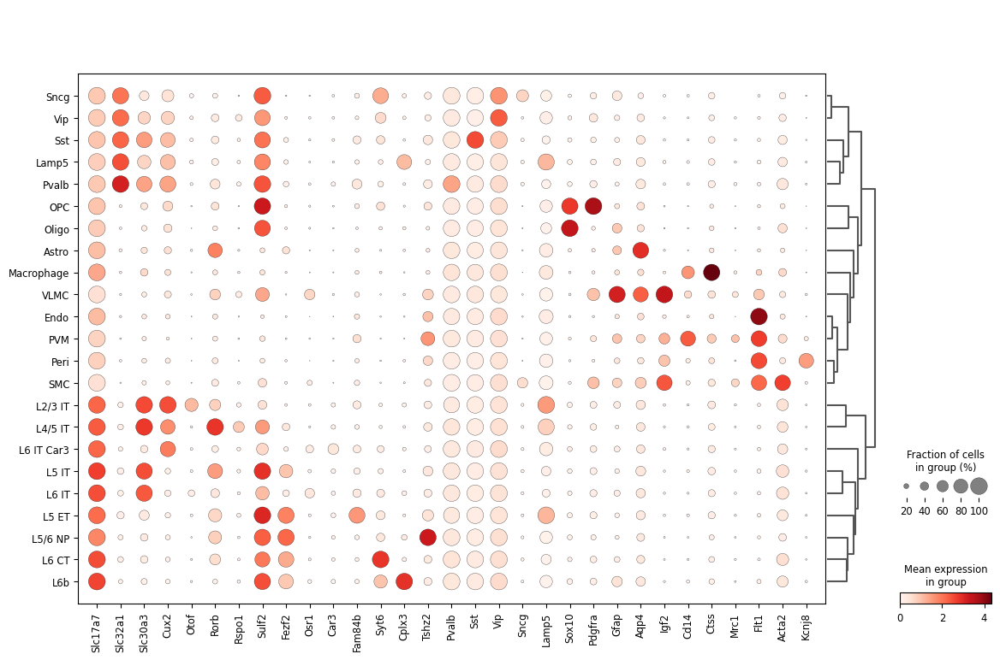

All slices: ['mouse1_slice112', 'mouse1_slice122', 'mouse1_slice131', 'mouse1_slice153']


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


All slices: ['mouse1_slice112', 'mouse1_slice122', 'mouse1_slice131', 'mouse1_slice153']


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


===> Fig4A


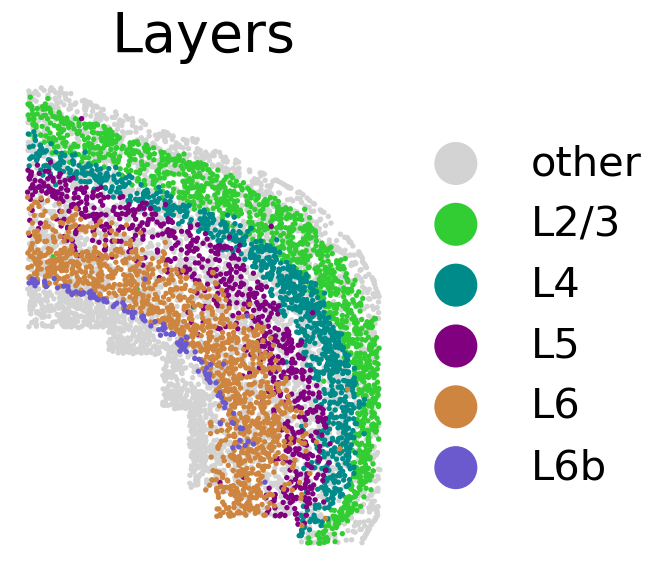

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


====> Fig4B


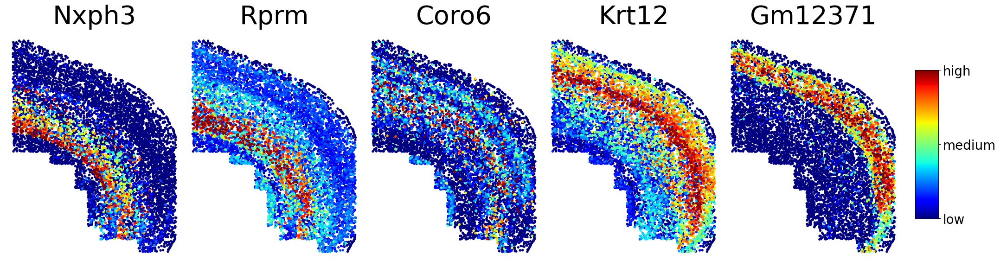

All slices: ['mouse1_slice112', 'mouse1_slice122', 'mouse1_slice131', 'mouse1_slice153']


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


All slices: ['mouse1_slice112', 'mouse1_slice122', 'mouse1_slice131', 'mouse1_slice153']


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


===> save IT layers-based file for deg analysis at /home/jy/rongboshen/spagda/mop/application/Results/sweden_imputed.h5ad


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1671776/1177442047.py:56: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sub_imputed_it_adata.obs['Layers']  = list(sub_imputed_it_adata.obs['subclass'].replace(source_cell_types, target_cell_types))
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plott

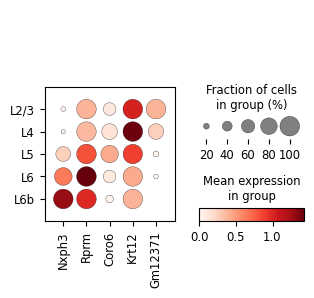

In [3]:
## draw Fig4 A,B, and expression matrix for Fig4C @meilin

'''
===> Fig4A

====> Fig4B

===> save IT layers-based file for deg analysis at 
/home/jy/rongboshen/spagda/mop/application/Results/sweden_imputed.h5ad for Fig4C@ meilin
'''


data_dir = '/home/jy/rongboshen/spagda/mop/application/data'

adata = sc.read(os.path.join(data_dir, 'MERFISH.h5ad'))
markers = ['Slc17a7', 'Slc32a1', 'Slc30a3', 'Cux2', 'Otof', 'Rorb',
           'Rspo1', 'Sulf2', 'Fezf2', 'Osr1', 'Car3', 'Fam84b',
           'Syt6', 'Cplx3', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg',
           'Lamp5', 'Sox10', 'Pdgfra', 'Gfap', 'Aqp4', 'Igf2', 'Cd14',
           'Ctss', 'Mrc1', 'Flt1', 'Acta2', 'Kcnj8']

save_dir = '/home/jy/rongboshen/spagda/mop/application/degs'
if not os.path.exists(save_dir): os.makedirs(save_dir)
sc.settings.figdir = save_dir


SpaGDA_imputed_sweden = pd.read_csv(os.path.join(data_dir, 'gan_DAGAN_FiveFolds_2022-10-14-16-57-16.csv'), 
                                    header=0, index_col=0, sep=',')
genes = SpaGDA_imputed_sweden.columns.to_list()

var = pd.DataFrame(index=genes)
sweden_imputed_adata = AnnData(SpaGDA_imputed_sweden.to_numpy(), obs=adata.obs, var=var, dtype='float32')
sweden_imputed_adata.obsm['spatial'] = adata.obsm['spatial']

# draw DEG genes dotplot for raw merfish st dataset
adata = adata[~adata.obs.cell_types.isin(['other']),:]
adata.obs['subclass'] = adata.obs['cell_types']
sc.pl.dotplot(adata, markers, groupby='subclass', dendrogram=True, swap_axes=False, save='markers.pdf')


# draw marker genes with sweden database
genes_set1 = ['Nxph3', 'Rprm', 'Coro6', 'Krt12', 'Gm12371']
draw_visual_genes_mop_and_layer(sweden_imputed_adata, save_dir, 'sweden_main', genes_set1)
draw_visual_genes_mop_and_layer_slice(sweden_imputed_adata, save_dir, 'sweden_main_153', genes_set1)


genes_set2 = ['Bmp3', 'Sstr2', 'Scube1', 'Tnnc1', 'A830009L08Rik']
draw_visual_genes_mop_and_layer(sweden_imputed_adata, save_dir, 'sweden_extend', genes_set2)
genes_set3 = ['3110035E14Rik', 'Tbr1', 'Hs3st4', 'Nov', 'Hs3st2', 'Dkkl1', 'A830036E02Rik', 'Rasl10a']
draw_visual_genes_mop_and_layer(sweden_imputed_adata, save_dir, 'sweden_other', genes_set3)

# draw dotplot for gene set1
source_cell_types = ['L2/3 IT','L4/5 IT','L5 IT','L6 IT','L5 ET','L5/6 NP','L6 CT','L6b','L6 IT Car3']
target_cell_types = ['L2/3','L4','L5','L6','L5','L5','L6','L6b','L6']
sub_imputed_it_adata = sweden_imputed_adata[sweden_imputed_adata.obs.subclass.isin(source_cell_types),:]
sub_imputed_it_adata.obs['Layers']  = list(sub_imputed_it_adata.obs['subclass'].replace(source_cell_types, target_cell_types))

file_path = '/home/jy/rongboshen/spagda/mop/application/Results/sweden_imputed.h5ad'
print('===> save IT layers-based file for deg analysis at %s'%file_path)
sub_imputed_it_adata.write(file_path)

sc.pl.dotplot(sub_imputed_it_adata, genes_set1, groupby='Layers', swap_axes=False, save='IT_layers.pdf')
#sc.pl.stacked_violin(sub_imputed_it_adata, genes_set1, groupby='Layers', swap_axes=False, save='IT_layers.pdf')#cmap='jet', 
#sc.pl.matrixplot(sub_imputed_it_adata, genes_set1, groupby='Layers', swap_axes=False, save='IT_layers.pdf')#cmap='RdBu_r'
#sc.pl.tracksplot(sub_imputed_it_adata, genes_set1, groupby='Layers', swap_axes=False, save='IT_layers.pdf')


         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is d

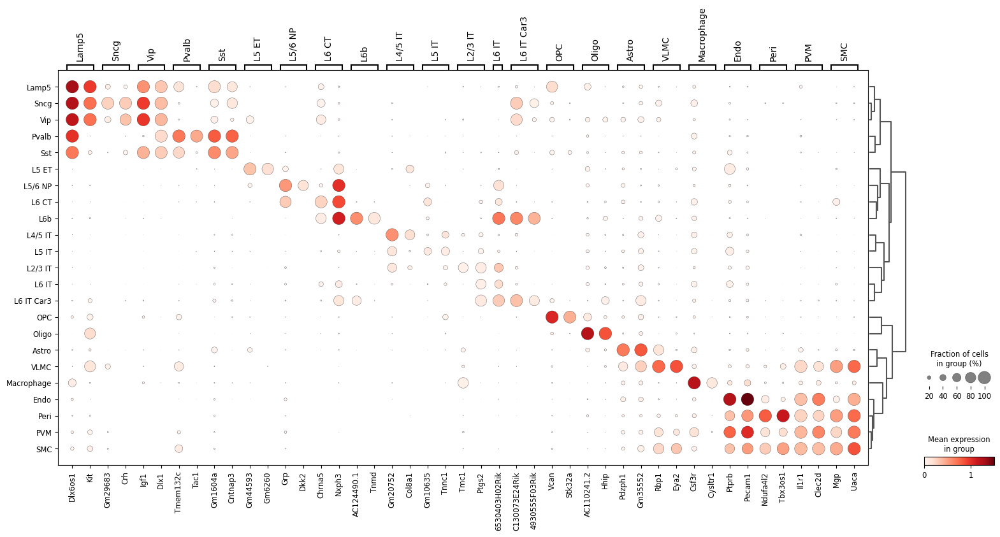

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


===> Fig4D


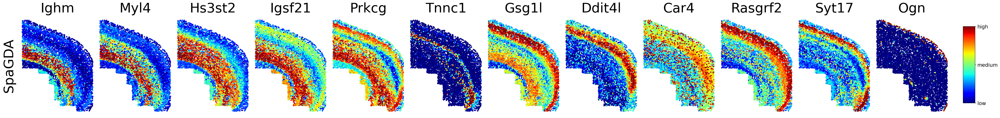

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


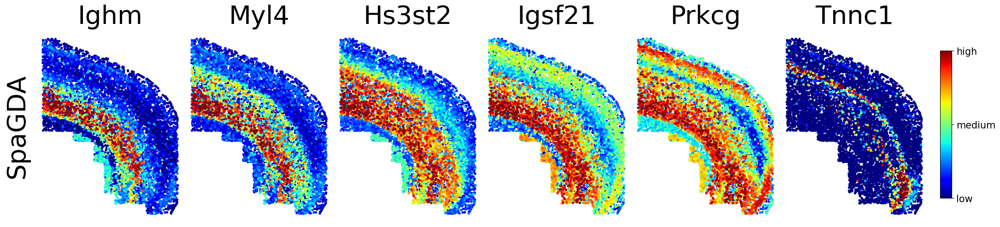

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


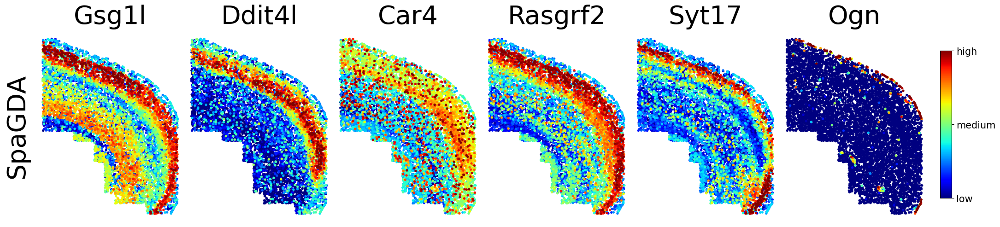

In [4]:
## draw Fig4 D

'''
===> Fig4D

'''



# load imputed 1000 genes merfish st dataset.
imputed_st_file = '/home/jy/rongboshen/spagda/mop/application/Results/imputed_merfish_m1s3.h5ad'

imputed_adata = sc.read(imputed_st_file)
imputed_adata.obs['subclass'] = list(imputed_adata.obs['cell_types'])
raw_imputed_adata = imputed_adata.copy()
imputed_adata = imputed_adata[~imputed_adata.obs.cell_types.isin(['other']),:]


check_cell_types = ['L2/3 IT','L4/5 IT','L5 IT','L6 IT','L5 ET','L5/6 NP','L6 CT','L6b','L6 IT Car3']
visual_imputed_adata = imputed_adata[imputed_adata.obs.subclass.isin(check_cell_types),:]

'''
sc.tl.rank_genes_groups(imputed_adata, groupby='subclass', method='wilcoxon') 
sc.pl.rank_genes_groups_dotplot(imputed_adata, n_genes=2, save='imputed.pdf')
sc.tl.filter_rank_genes_groups(imputed_adata, min_in_group_fraction=0.5, max_out_group_fraction=0.3, min_fold_change=2)
sc.pl.rank_genes_groups_dotplot(imputed_adata, n_genes=4, key='rank_genes_groups_filtered', dendrogram=True, save='imputed_filter.pdf')

sc.tl.rank_genes_groups(visual_imputed_adata, groupby='subclass', method='wilcoxon') 
sc.pl.rank_genes_groups_dotplot(visual_imputed_adata, n_genes=2, save='imputed_visual.pdf')
sc.tl.filter_rank_genes_groups(visual_imputed_adata, min_in_group_fraction=0.5, max_out_group_fraction=0.3, min_fold_change=2)
sc.pl.rank_genes_groups_dotplot(visual_imputed_adata, n_genes=4, key='rank_genes_groups_filtered', dendrogram=True, save='imputed_visual_filter.pdf')
'''

deg_markers = {'Lamp5':['Dlx6os1', 'Kit'],
                'Sncg': ['Gm29683', 'Crh'],
                'Vip': ['Igf1', 'Dlx1'],
                'Pvalb': ['Tmem132c', 'Tac1'],
                'Sst': ['Gm1604a', 'Cntnap3'],
                'L5 ET': ['Gm44593', 'Gm6260'],
                'L5/6 NP': ['Grp', 'Dkk2'],
                'L6 CT': ['Chrna5', 'Nxph3'],
                'L6b': ['AC124490.1', 'Tnmd'],
                'L4/5 IT': ['Gm20752', 'Col8a1'], 
                'L5 IT': ['Gm10635', 'Tnnc1'], 
                'L2/3 IT': ['Tmc1', 'Ptgs2'], 
                'L6 IT': ['6530403H02Rik'], 
                'L6 IT Car3' : ['C130073E24Rik', '4930555F03Rik'],
                'OPC': ['Vcan', 'Stk32a'], 
                'Oligo': ['AC110241.2', 'Hhip'],
                'Astro': ['Pdzph1', 'Gm35552'],
                'VLMC': ['Rbp1', 'Eya2'], 
                'Macrophage': ['Csf3r', 'Cysltr1'],
                'Endo': ['Ptprb', 'Pecam1'],
                'Peri': ['Ndufa4l2', 'Tbx3os1'],
                'PVM': ['Il1r1', 'Clec2d'],
                'SMC': ['Mgp', 'Uaca']
                }
sc.pl.dotplot(imputed_adata, deg_markers, groupby='subclass', dendrogram=True, 
              swap_axes=False, save='deg.pdf')

# draw demo genes with allen ish
main_genes = ['Ighm', 'Myl4', 'Hs3st2', 'Igsf21', 'Prkcg', 'Tnnc1', 'Gsg1l', 
              'Ddit4l', 'Car4', 'Rasgrf2', 'Syt17', 'Ogn']
demo_adata = raw_imputed_adata[raw_imputed_adata.obs.slice_id=='mouse1_slice153', :]

coords = np.array(demo_adata.obsm['spatial'])
_coords, _, _ =  alignment(coords)           
x_locs, y_locs = _coords[:,0], _coords[:,1]

fig, axs = plt.subplots(1, 12, figsize=(50,8), gridspec_kw={'hspace':0, 'wspace':0})

for j,gene in enumerate(main_genes):
    if j == 0:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, 'SpaGDA')
    else:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, None)

cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
cbar = fig.colorbar(sca, cax=cb_ax)
cbar.ax.tick_params(labelsize=15)
cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15)
fig.savefig(os.path.join(save_dir, 'genes_compare_allen.pdf'), bbox_inches='tight', dpi=100)
print('===> Fig4D')
plt.show()
plt.close()


fig, axs = plt.subplots(1, 6, figsize=(25,8), gridspec_kw={'hspace':0, 'wspace':0})
for j,gene in enumerate(main_genes[:6]):
    if j == 0:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, 'SpaGDA')
    else:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, None)

cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
cbar = fig.colorbar(sca, cax=cb_ax)
cbar.ax.tick_params(labelsize=15)
cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15)
fig.savefig(os.path.join(save_dir, 'genes_compare_allen_sub1.pdf'), bbox_inches='tight', dpi=100)
plt.show()
plt.close()

fig, axs = plt.subplots(1, 6, figsize=(25,8), gridspec_kw={'hspace':0, 'wspace':0})
for j,gene in enumerate(main_genes[6:]):
    if j == 0:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, 'SpaGDA')
    else:
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata[:,gene].X, x_locs, y_locs, gene, 15, None)

cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.4])
cbar = fig.colorbar(sca, cax=cb_ax)
cbar.ax.tick_params(labelsize=15)
cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15)
fig.savefig(os.path.join(save_dir, 'genes_compare_allen_sub2.pdf'), bbox_inches='tight', dpi=100)
plt.show()
plt.close()


In [5]:
def draw_axs_spatial_genes(ax, expression_values, x_locs, y_locs, title, ms, ylabel):

    ax.set_aspect(1)
    vmin = np.percentile(expression_values, 1)
    vmax = np.percentile(expression_values, 99)

    tmp = sorted(list(zip(expression_values,x_locs,y_locs)))
    expression_values, x_locs, y_locs = list(zip(*tmp))

    sca = ax.scatter(x=x_locs, y=y_locs, s=ms, c=expression_values, vmin=vmin, vmax=vmax, cmap='jet', edgecolors='none')

    for sp in ax.spines.values():
        sp.set_visible(False)

    ax.set_xticks([])
    ax.set_yticks([])
    if ylabel: ax.set_ylabel(ylabel, fontsize=40, labelpad=10)
    if title: ax.set_title(title.split('_')[-1], fontsize=40, pad=10)
    return sca, vmin, vmax

def draw_visual_module(adata, sub_save_dir, ext, modules):
    #### Visual SpaGDA imputation result in spatial

    slices = list(set(adata.obs.slice_id))
    slices.sort()
    print("All slices:", slices)
    #load the imputed gene values


    # Plot the modules on top of positions
    fig, axs = plt.subplots(len(modules), 4, figsize=(27,7*len(modules)), gridspec_kw={'hspace':0, 'wspace':0, 'width_ratios':np.array([1,1.6,0.8,1])})
    for i,nslice in enumerate(slices):
        slice_adata = adata[adata.obs.slice_id==nslice, :]
        coords = np.array(slice_adata.obsm['spatial'])
        _coords, _, _ =  alignment(coords)
        if nslice == 'mouse1_slice112':
            _coords, _, _ = alignment(verizontal(horizontal(_coords)))
        elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
            _coords, _, _ = alignment(horizontal(_coords))            
        x_locs, y_locs = _coords[:,0], _coords[:,1]
        for j,module in enumerate(modules):
            if j == 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, nslice, 10, module)
            elif j == 0 and i != 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, nslice, 10, None)
            elif j != 0 and i == 0:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, None, 10, module)
            else:
                sca, vmin, vmax = draw_axs_spatial_genes(axs[j,i], slice_adata.obs[module], x_locs, y_locs, None, 10, None)

    cb_ax = fig.add_axes([0.4, 0.08, 0.2, 0.06/len(modules)])
    cbar = fig.colorbar(sca, cax=cb_ax, orientation='horizontal')
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=20)

    fig.savefig(os.path.join(sub_save_dir, '%s.pdf'%ext), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close()


def local_correlation_plot(local_correlation_z, modules, linkage, mod_cmap='tab20', vmin=-8, vmax=8, z_cmap='RdBu_r', yticklabels=False, ext='', reorder_ind=False): 
    row_colors = None
    colors = list(plt.get_cmap(mod_cmap).colors)
    module_colors = {i: colors[(i-1) % len(colors)] for i in modules.unique()}
    module_colors[-1] = '#ffffff'

    row_colors1 = pd.Series(
        [module_colors[i] for i in modules],
        index=local_correlation_z.index,
    )

    row_colors = pd.DataFrame({
        "Modules": row_colors1,
    })

    cm = sns.clustermap(local_correlation_z, row_linkage=linkage, col_linkage=linkage, vmin=vmin, vmax=vmax, cmap=z_cmap,
                        xticklabels=False, yticklabels=yticklabels, row_colors=row_colors, rasterized=True, cbar_pos=(1.02, 0.2, 0.03, 0.2))

    if reorder_ind:
        genes_list = modules.index.to_list()
        module_list = list(modules)
        genes, _modules = [], []
        for ind in cm.dendrogram_row.reordered_ind:
            genes.append(genes_list[ind])
            _modules.append(module_list[ind])

        reorder_df = pd.DataFrame()
        reorder_df['reorder_ind'] = cm.dendrogram_row.reordered_ind
        reorder_df['gene'] = genes
        reorder_df['modules'] = _modules


        reorder_df.to_csv(os.path.join(save_dir, 'modules_test_153_reorder.csv')) 

    fig = plt.gcf()
    plt.sca(cm.ax_heatmap)
    plt.ylabel("")
    plt.xlabel("")

    cm.ax_row_dendrogram.remove()
    cm.ax_col_dendrogram.remove()

    # Add 'module X' annotations
    ii = leaves_list(linkage)

    mod_reordered = modules.iloc[ii]

    mod_map = {}
    y = np.arange(modules.size)

    for x in mod_reordered.unique():
        if x == -1:
            continue

        mod_map[x] = y[mod_reordered == x].mean()

    plt.sca(cm.ax_row_colors)
    for mod, mod_y in mod_map.items():
        plt.text(-.5, y=mod_y, s="M{}".format(mod), fontsize='xx-large',
                 horizontalalignment='right',
                 verticalalignment='center')
    plt.xticks([])

    # Find the colorbar 'child' and modify
    min_delta = 1e99
    min_aa = None
    for aa in fig.get_children():
        try:
            bbox = aa.get_position()
            delta = (0-bbox.xmin)**2 + (1-bbox.ymax)**2
            if delta < min_delta:
                delta = min_delta
                min_aa = aa
        except AttributeError:
            pass

    min_aa.set_ylabel('Z-Scores')
    min_aa.yaxis.set_label_position("left")
    plt.savefig(os.path.join(save_dir, 'module_local_correlation%s.pdf'%ext), bbox_inches='tight', dpi=100)

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


all zeros: 118
203
Index(['0610031O16Rik', '1100001I12Rik', '1500015O10Rik', '4930578C19Rik',
       '8430408G22Rik', 'A2m', 'A4gnt', 'A530020G20Rik', 'AC125149.3',
       'AC140304.1',
       ...
       'Tnni3k', 'Top2a', 'Tpx2', 'Trh', 'Trhr', 'Trpc7', 'Tspan8', 'Ube2c',
       'Vmn1r209', 'Vwf'],
      dtype='object', length=203)


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1671776/1248747416.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pred_adata2.obs['total_counts'] = list(np.sum(pred_adata2.layers['counts'], axis=1))
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not i

                      C           Z  Pval  FDR
Gene                                          
Hs6st3         0.487647  152.669936   0.0  0.0
A830036E02Rik  0.551507  149.233648   0.0  0.0
Pde7b          0.563349  147.315074   0.0  0.0
Cmtm5          0.530588  143.656977   0.0  0.0
Dbi            0.501342  142.883730   0.0  0.0
Bmp6           0.325444  142.608130   0.0  0.0
Pdzrn3         0.514956  141.730475   0.0  0.0
Cd9            0.461081  137.556880   0.0  0.0
Rasgrf2        0.538458  134.370696   0.0  0.0
Mapk4          0.519475  131.394527   0.0  0.0
Kcnh5          0.430831  129.777252   0.0  0.0
Cryab          0.488005  129.383553   0.0  0.0
Sntg2          0.485970  128.890294   0.0  0.0
Col19a1        0.494935  127.875809   0.0  0.0
Plp1           0.481729  127.473883   0.0  0.0
Pparg          0.457038  127.329749   0.0  0.0
Ddit4l         0.492231  126.677168   0.0  0.0
A330008L17Rik  0.462714  124.354115   0.0  0.0
Car2           0.459030  124.090668   0.0  0.0
Ptchd4       

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 256686/256686 [00:23<00:00, 10941.54it/s]


Computing scores for 5 modules...


  0%|                                                                                                                                                                      | 0/5 [00:00<?, ?it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 20%|███████████████████████████████▌                                                                                                                              | 1/5 [00:00<00:01,  2.30it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 40%|███████████████████████████████████████████████████████████████▏         

===> Fig4E
===> Fig4F


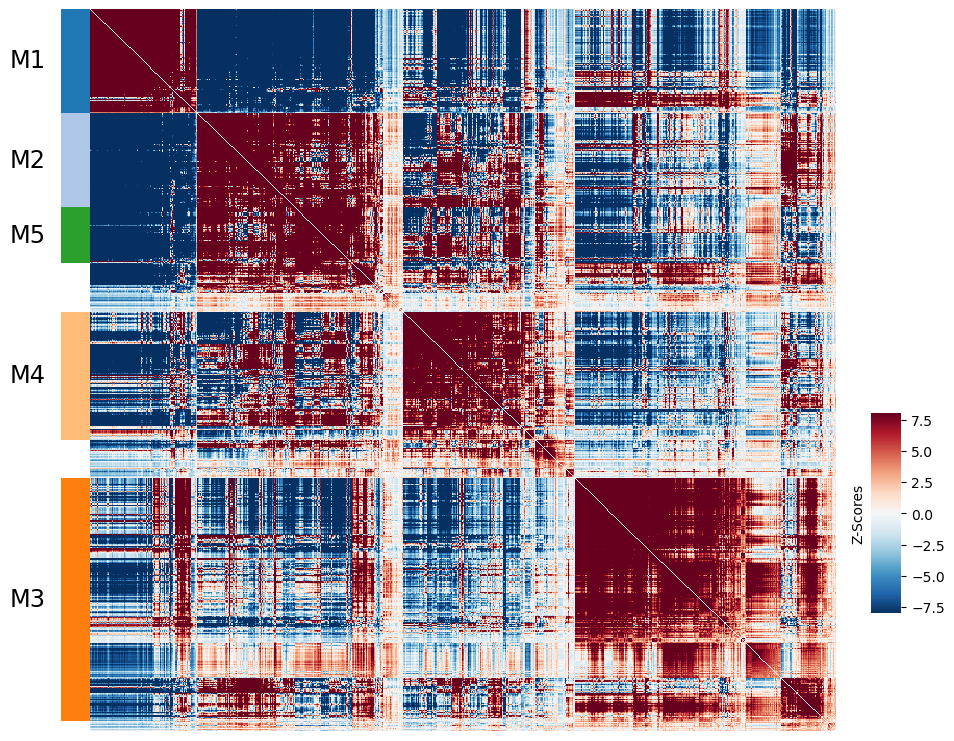

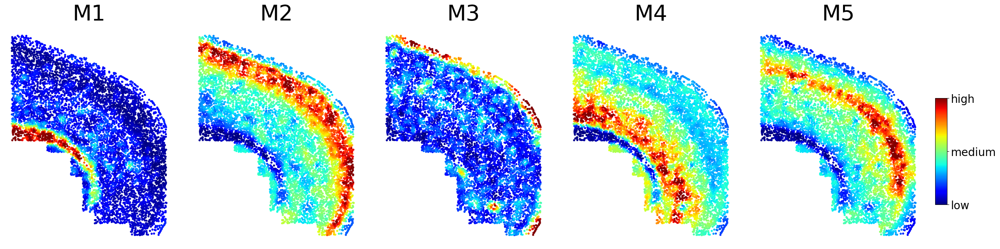

===> file data was restored at /home/jy/rongboshen/spagda/mop/application/Results/diff_slice153.h5ad
==> Module 1 with 103 genes:


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


==> Module 2 with 94 genes:
==> Module 3 with 241 genes:
==> Module 4 with 127 genes:
==> Module 5 with 55 genes:
top genes in each module of slice153


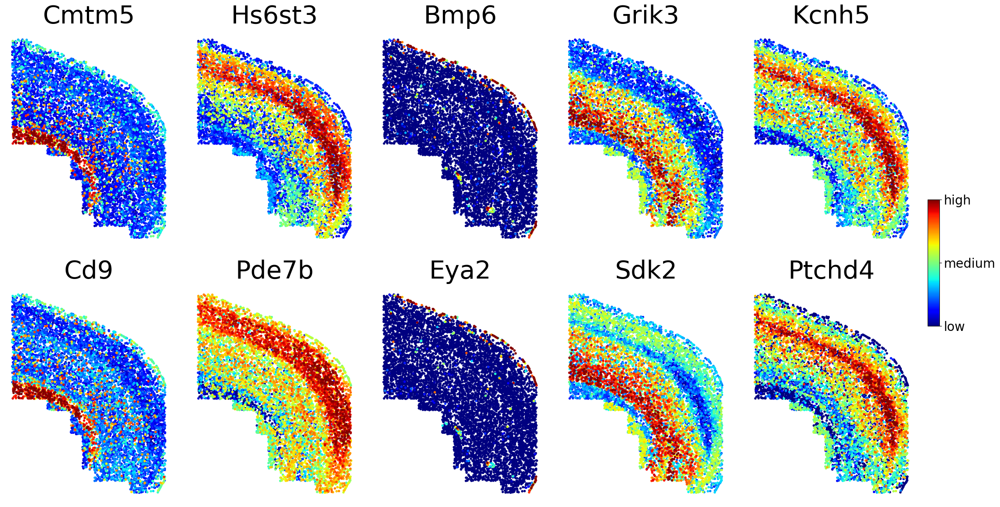

In [6]:
## draw Fig4E and Fig4F

'''
===> Fig4E
===> Fig4F

'''


np.random.seed(42)
# hotspot analysis
merfish_mouse1_sample3 = '/data/bioinf/jyuan/rongboshen/datasets/mop/mouse1_sample3.h5ad'
st_adata = sc.read(merfish_mouse1_sample3)
with open('/home/jy/rongboshen/spagda/mop/application/data/shared_genes.json') as fs:
    shared_genes = json.load(fs)

st_adata = st_adata[:,st_adata.var_names.isin(shared_genes)]

total_counts = np.sum(st_adata.X, axis=1)
median_value = np.median(total_counts)
output_st_file = '/home/jy/rongboshen/spagda/mop/application/Results/output_merfish_m1s3.h5ad'
pred_adata = sc.read(output_st_file)
all_zeros = np.sum(np.sum(pred_adata.X, axis=0)==0)
print('all zeros:',all_zeros)
pred_adata_arr = np.exp(pred_adata.X) - 1
pred_adata_arr = pred_adata_arr / median_value
pred_adata_arr = np.array(pred_adata_arr, dtype='float32')
for k,v in enumerate(list(total_counts)):
    pred_adata_arr[k] = pred_adata_arr[k] * v

pred_adata_arr = np.around(pred_adata_arr)
pred_adata_arr = pred_adata_arr.astype(np.int32)
pred_total_counts = np.sum(pred_adata_arr, axis=1)
pred_adata.layers['counts'] = pred_adata_arr

pred_adata.obs['total_counts'] = pred_total_counts
pred_adata.write('/home/jy/rongboshen/spagda/mop/application/Results/pred_merfish.h5ad')

#sc.pp.filter_genes(pred_adata, min_counts=1)
filter_genes = pred_adata.var_names[np.sum(pred_adata_arr, axis=0)==0]
print(len(filter_genes))
print(filter_genes)
with open('/home/jy/rongboshen/spagda/mop/application/Results/pred_filter.json', 'w') as fs:
    json.dump(filter_genes.tolist(), fs)
pred_adata = pred_adata[:,~pred_adata.var_names.isin(list(filter_genes))]
#sc.tl.pca(pred_adata)


import hotspot
slices = list(set(pred_adata.obs.slice_id))
slices.sort()

pred_adata2 = pred_adata.copy()
pred_adata2 = pred_adata2[:,~pred_adata2.var_names.isin(shared_genes)]
pred_adata2.obs['total_counts'] = list(np.sum(pred_adata2.layers['counts'], axis=1))

demo_adata2 = pred_adata2[pred_adata2.obs.slice_id=='mouse1_slice153', :]
filter_genes_demo2 = demo_adata2.var_names[np.sum(demo_adata2.layers['counts'], axis=0)==0]
demo_adata2 = demo_adata2[:,~demo_adata2.var_names.isin(list(filter_genes_demo2))]


hs = hotspot.Hotspot(demo_adata2, layer_key='counts', model='danb', latent_obsm_key='spatial', 
                     umi_counts_obs_key='total_counts')
hs.create_knn_graph(weighted_graph=False, n_neighbors=20)
hs_results = hs.compute_autocorrelations()
hs_results = hs_results.sort_values('Z', ascending=False)

print(hs_results.head(50))

raw_genes = hs_results.index
hs_genes = hs_results.loc[hs_results.FDR < 0.01].index
filtered_genes = set(raw_genes) - set(hs_genes)
print(len(filtered_genes), filtered_genes)
local_correlations = hs.compute_local_correlations(hs_genes, jobs=8)
modules = hs.create_modules(min_gene_threshold=50, core_only=True, fdr_threshold=0.01)
module_scores = hs.calculate_module_scores()

results = hs.results.join(hs.modules)
module_gene_dict = {}
for module in range(1, hs.modules.max()+1):
    module_results = results.loc[results.Module == module]
    module_gene_dict['M%d'%module] = module_results.index.tolist()
    demo_adata2.obs['M%d'%module] = hs.module_scores[module]

gene_zscore = []
glist = hs_results.index.tolist()
for g in demo_adata2.var_names.tolist():
    idx = glist.index(g)
    gene_zscore.append(hs_results['Z'].tolist()[idx])
demo_adata2.var['zscore'] = gene_zscore


coords = np.array(demo_adata2.obsm['spatial'])
_coords, _, _ =  alignment(coords) 
print('===> Fig4E')
local_correlation_plot(local_correlation_z=hs.local_correlation_z, modules=hs.modules, linkage=hs.linkage, ext='test', reorder_ind=True)              
x_locs, y_locs = _coords[:,0], _coords[:,1]


fig, axs = plt.subplots(1, hs.modules.max(), figsize=(30,9), gridspec_kw={'hspace':0.0, 'wspace':0.1})
for j, module in enumerate(['M%d'%x for x in range(1, hs.modules.max()+1)]):
    sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata2.obs[module], x_locs, y_locs, module, 15, None)

cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.3])
cbar = fig.colorbar(sca, cax=cb_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
cbar.set_ticklabels(['low', 'medium', 'high'])#, labelsize=15)
print('===> Fig4F')
fig.savefig(os.path.join(save_dir, 'spatial_modules_test153.pdf'), bbox_inches='tight', dpi=100)
plt.show()
plt.close()

save_path = '/home/jy/rongboshen/spagda/mop/application/Results/diff_slice153.h5ad'
demo_adata2.write(save_path)
print('===> file data was restored at %s'%save_path)

# Plot top 2 genes in selected modules of slice153
results = hs.results.join(hs.modules)
fig, axs = plt.subplots(2, hs.modules.max(), figsize=(26, 14), gridspec_kw={'hspace':0.1, 'wspace':0.1})
for j, module in enumerate(range(1, hs.modules.max()+1)):
    module_results = results.loc[results.Module == module]
    print('==> Module %d with %d genes:'%(module, module_results.shape[0]))
    genes = module_results.sort_values('Z', ascending=False).head(3).index.tolist()
    _genes = [genes[0], genes[-1]]
    for i, g in enumerate(_genes):
        sca, vmin, vmax = draw_axs_spatial_genes(axs[i,j], demo_adata2[:, g].X, x_locs, y_locs, g, 15, None)
cb_ax = fig.add_axes([0.91, 0.4, 0.01, 0.2])
cbar = fig.colorbar(sca, cax=cb_ax)
cbar.ax.tick_params(labelsize=20)
cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
cbar.set_ticklabels(['low', 'medium', 'high'])#, fontsize=15)
print('top genes in each module of slice153')
fig.savefig(os.path.join(save_dir, 'top_genes_spatial_modules_slice153.pdf'), bbox_inches='tight', dpi=100)
plt.show()
plt.close()



In [7]:
# For GO Term analysis. Fig4G @meilin
'''
===> Genes in each spatial modules were save in 
/home/jy/rongboshen/spagda/mop/application/degs/hotspot_modules_test.csv
'''
module_gene_path = os.path.join(save_dir, 'hotspot_modules_test.csv')
results.sort_values(by=['Module', 'Z'], ascending=[True, False]).to_csv(module_gene_path)
print('===> Genes in each spatial modules were save in %s'%module_gene_path)


===> Genes in each spatial modules were save in /home/jy/rongboshen/spagda/mop/application/degs/hotspot_modules_test.csv


/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


13
mouse1_slice112
Index(['7630403G23Rik', 'Atf3', 'Bmp4', 'Bmp5', 'Col1a1', 'Gm45323', 'Mpzl2',
       'Pdyn', 'Rhbdl2', 'Slc16a12', 'Spp1', 'Srarp', 'Ttr'],
      dtype='object')


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1036/1036 [00:00<00:00, 1068.98it/s]
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Computing pair-wise local correlation on 910 features...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 413595/413595 [00:22<00:00, 18521.08it/s]


Computing scores for 5 modules...


 20%|███████████████████████████████▌                                                                                                                              | 1/5 [00:00<00:00,  6.85it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 2/5 [00:00<00:00,  4.94it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 60%|█████████████████████████████████████████████████████████████████████████

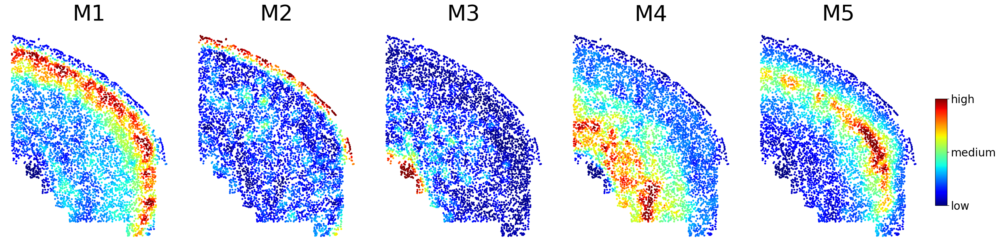

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


5
mouse1_slice122
Index(['Gm30624', 'Gm40518', 'Htr3a', 'Pdyn', 'Slc16a12'], dtype='object')


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1044/1044 [00:01<00:00, 1030.93it/s]
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Computing pair-wise local correlation on 936 features...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 437580/437580 [00:31<00:00, 13930.45it/s]


Computing scores for 5 modules...


 20%|███████████████████████████████▌                                                                                                                              | 1/5 [00:00<00:00,  7.92it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 2/5 [00:00<00:00,  3.94it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 60%|█████████████████████████████████████████████████████████████████████████

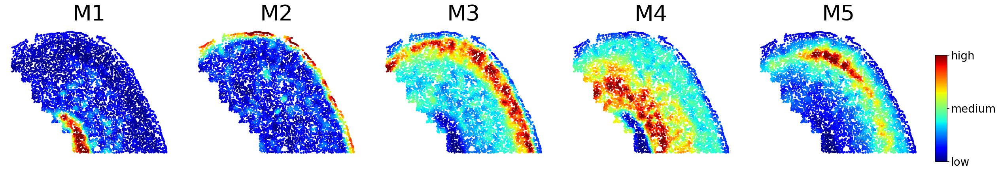

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


10
mouse1_slice131
Index(['7630403G23Rik', 'Alkal2', 'Bmp4', 'Bmp5', 'Col1a1', 'Gm40518', 'Htr3a',
       'Mpzl2', 'Pf4', 'Rhbdl2'],
      dtype='object')


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1039/1039 [00:00<00:00, 1109.33it/s]
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Computing pair-wise local correlation on 918 features...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 420903/420903 [00:23<00:00, 17960.37it/s]


Computing scores for 5 modules...


 20%|███████████████████████████████▌                                                                                                                              | 1/5 [00:00<00:00,  8.37it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 2/5 [00:00<00:00,  4.92it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 60%|█████████████████████████████████████████████████████████████████████████

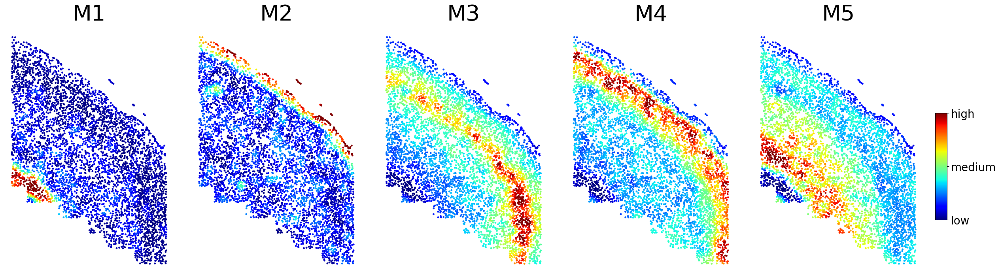

/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


12
mouse1_slice153
Index(['4930467D21Rik', '7630403G23Rik', 'Alkal2', 'Bmp4', 'Col1a1', 'Fndc1',
       'Gm40518', 'Mpzl2', 'Pdyn', 'Pf4', 'Ptgs2', 'Rhbdl2'],
      dtype='object')


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1037/1037 [00:01<00:00, 777.16it/s]
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Computing pair-wise local correlation on 934 features...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 435711/435711 [00:39<00:00, 11109.07it/s]


Computing scores for 5 modules...


 20%|███████████████████████████████▌                                                                                                                              | 1/5 [00:00<00:00,  6.28it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 2/5 [00:00<00:00,  6.08it/s]/home/jy/JYuan/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
 60%|█████████████████████████████████████████████████████████████████████████

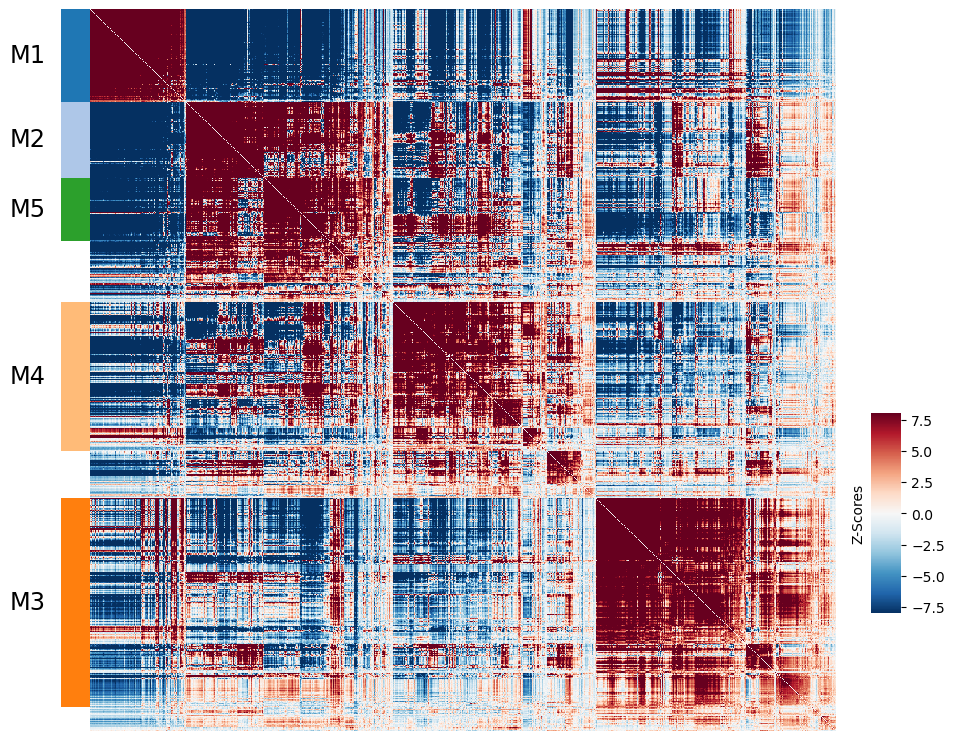

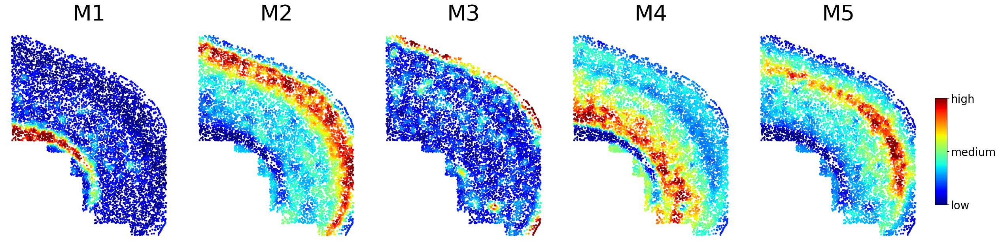

===> slice153 imputed results for Fig4 G,H,I,J
===> file data was restored at /home/jy/rongboshen/spagda/mop/application/Results/slice153.h5ad


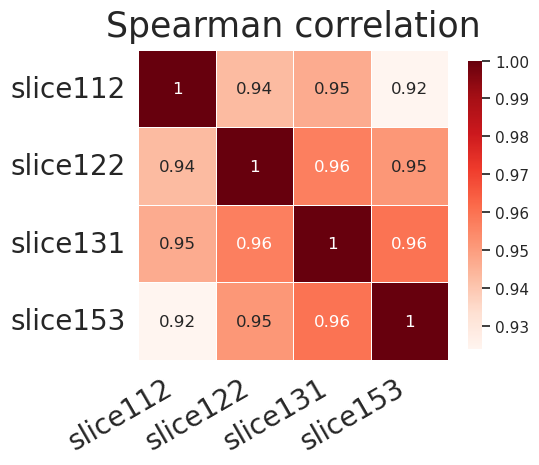

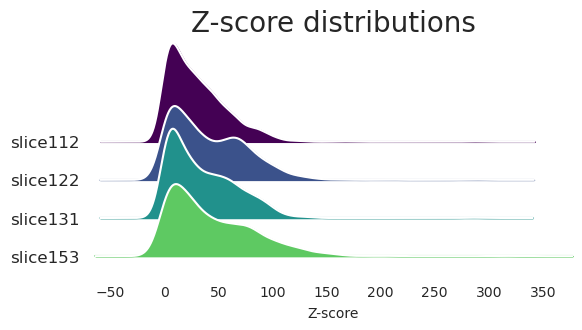

==> Fold: 1
==> Imputed genes: ['9630013A20Rik', 'Npy', 'Myoc', 'Adarb2', 'Mgp', 'Ptgds', 'Ly6c1', 'Ctgf', 'Bnc2', 'Klf2', 'Cd74', 'Prg4', 'Ly6a', 'Gm10635', 'Cnksr3', 'Slco1a4', 'Apoe', 'Gm26883', 'Tac1', 'Adgrl4', 'F13a1', 'Crh', 'Erbb4', 'Bcas1', 'Cxcl12', 'Fn1', 'H2-Eb1', 'Mal', 'H2-Ab1', 'Dlx6os1', 'Vwc2l', 'Slc47a1', 'Cort', 'Itm2a', 'Pltp', 'Plp1', 'Gm32647', 'Cntnap5c', 'Cxcl10', 'Btbd11', 'Id1', 'Nckap5', 'Slc6a20a', 'H2-Aa', 'Hbb-bs', 'Kcnmb2', 'Mecom', 'Apod', 'Lhfpl3', 'St18', 'Synpr', 'Fam19a1', 'Slc2a1', 'AC121788.1', 'Mobp', 'Fgf13', 'Kcnip1', 'Gm13822', 'Ndnf', 'Bmp6', 'Hba-a1', 'Olfr111', 'Tcf7l2', 'Hba-a2', 'Vcan', 'Kit', 'Rprm', 'Galntl6', 'Gm2164', 'Ebf1', 'Spp1', 'Htr2c', 'Yjefn3', 'Fabp7', 'Igfbpl1', 'Pglyrp1', 'Id3', 'Mbp', 'Grip1', 'Dlx1as', 'Gpc5', 'Cldn11', 'Crhbp', 'C130073E24Rik', 'C1qa', 'Cst3', 'Rbp4', 'Trpm3', 'Eya2', 'Inpp5d', '4930555F03Rik', 'Ttr', 'Hspb1', 'Prr5l', 'Hbb-bt', 'Tacr1', 'Tnmd', 'Igf1', 'Gm26905', 'Gm38505']
==> Fold: 2
==> Imputed genes:

/tmp/ipykernel_1671776/4193005693.py:145: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-white')


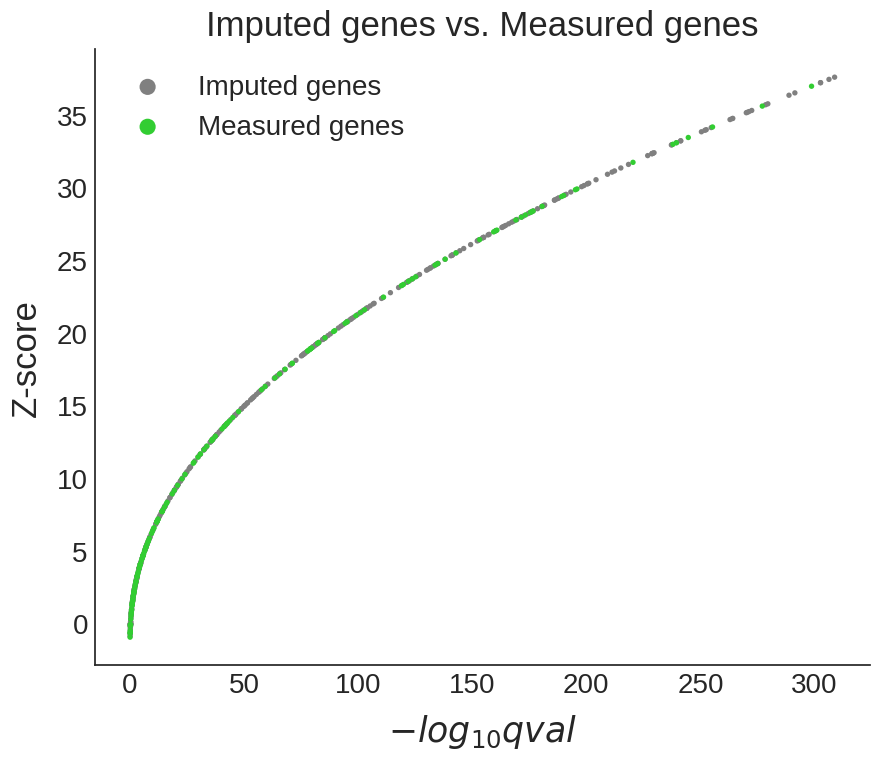

/tmp/ipykernel_1671776/4193005693.py:190: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-white')


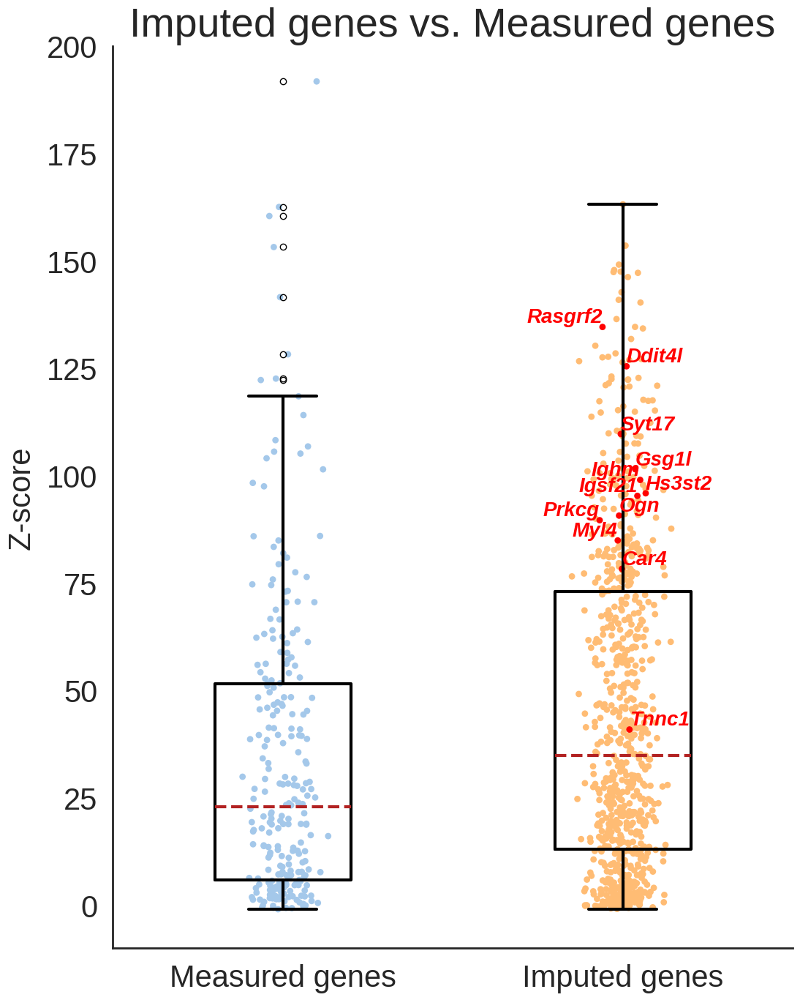

In [8]:
## slice153.h5ad for Fig4 H,I,J @meilin and other results may be used in Fig S
'''
===> slice153 imputed results for Fig4 H,I,J
===> file data was restored at /home/jy/rongboshen/spagda/mop/application/Results/slice153.h5ad

'''

def draw_matrix_map(matrix, save_dir, name, label_x, label_y):
    sns.set(font_scale=1)
    fig, ax = plt.subplots(figsize=(5,5))
    ax = sns.heatmap(matrix, ax=ax, cbar=True, cbar_kws={'shrink':0.75}, annot=True, linewidths=0.5,
                     cmap='Reds', square=True, xticklabels=label_x, yticklabels=label_y)
    ax.tick_params(labelsize=20)
    ax.set_title('Spearman correlation', fontsize=25, pad=10)
    plt.yticks(rotation=0)
    plt.xticks(rotation=30, ha='right') 
    fig.savefig(os.path.join(save_dir, '%s.pdf'%name), bbox_inches='tight')
    plt.show()
    plt.close()


genes_list= []
zscore_list = []
logqval_list = []
module_gene_dict_list = []


for nslice in slices:
    demo_adata = pred_adata[pred_adata.obs.slice_id==nslice, :]
    filter_genes_demo = demo_adata.var_names[np.sum(demo_adata.layers['counts'], axis=0)==0]
    print(len(filter_genes_demo))
    print(nslice)
    print(filter_genes_demo)
    demo_adata = demo_adata[:,~demo_adata.var_names.isin(list(filter_genes_demo))]
    hs = hotspot.Hotspot(demo_adata, layer_key='counts', model='danb', latent_obsm_key='spatial', umi_counts_obs_key='total_counts')
    hs.create_knn_graph(weighted_graph=False, n_neighbors=20)
    hs_results = hs.compute_autocorrelations()
    hs_results = hs_results.sort_values('Z', ascending=False)

    genes_list.append(hs_results.index.tolist())
    zscore_list.append(hs_results['Z'].tolist())
    logqval_list.append(list(-np.log10(hs_results['FDR'])))

    raw_genes = hs_results.index
    hs_genes = hs_results.loc[hs_results.FDR < 0.01].index
    local_correlations = hs.compute_local_correlations(hs_genes, jobs=8)
    modules = hs.create_modules(min_gene_threshold=60, core_only=True, fdr_threshold=0.01)
    module_scores = hs.calculate_module_scores()

    results = hs.results.join(hs.modules)
    module_gene_dict = {}
    for module in range(1, hs.modules.max()+1):
        module_results = results.loc[results.Module == module]
        module_gene_dict['M%d'%module] = module_results.index.tolist()
        demo_adata.obs['M%d'%module] = hs.module_scores[module]

    gene_zscore = []
    glist = hs_results.index.tolist()
    for g in demo_adata.var_names.tolist():
        idx = glist.index(g)
        gene_zscore.append(hs_results['Z'].tolist()[idx])
    demo_adata.var['zscore'] = gene_zscore

    module_gene_dict_list.append(module_gene_dict)

    coords = np.array(demo_adata.obsm['spatial'])
    _coords, _, _ =  alignment(coords)     
    if nslice == 'mouse1_slice112':
        _coords, _, _ = alignment(verizontal(horizontal(_coords)))
    elif nslice =='mouse1_slice122' or nslice =='mouse1_slice131':
        _coords, _, _ = alignment(horizontal(_coords)) 
    else:
        local_correlation_plot(local_correlation_z=hs.local_correlation_z, modules=hs.modules, linkage=hs.linkage)              
    x_locs, y_locs = _coords[:,0], _coords[:,1]

    fig, axs = plt.subplots(1, hs.modules.max(), figsize=(30,9), gridspec_kw={'hspace':0.0, 'wspace':0.1})
    for j, module in enumerate(['M%d'%x for x in range(1, hs.modules.max()+1)]):
        sca, vmin, vmax = draw_axs_spatial_genes(axs[j], demo_adata.obs[module], x_locs, y_locs, module, 12, None)

    cb_ax = fig.add_axes([0.91, 0.3, 0.01, 0.3])
    cbar = fig.colorbar(sca, cax=cb_ax)
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks([vmin, (vmin+vmax)/2, vmax])
    cbar.set_ticklabels(['low', 'medium', 'high'])#, labelsize=15)
    fig.savefig(os.path.join(save_dir, 'spatial_modules_%s.pdf'%nslice), bbox_inches='tight', dpi=100)
    plt.show()
    plt.close()

    
    

# Plot top 2 genes in selected modules
results = hs.results.join(hs.modules)

# For GO Term analysis.
results.sort_values(by=['Module', 'Z'], ascending=[True, False]).to_csv(os.path.join(save_dir, 'hotspot_modules.csv'))

print('===> slice153 imputed results for Fig4 H,I,J')
save_path = '/home/jy/rongboshen/spagda/mop/application/Results/slice153.h5ad'
demo_adata.write(save_path)
print('===> file data was restored at %s'%save_path)
    
    

common_genes = set(genes_list[0]) & set(genes_list[1]) & set(genes_list[2]) & set(genes_list[3]) 

slice_names = [x.split('_')[-1] for x in slices]
zscore_arr = np.zeros((4, len(common_genes)), dtype='float32')
for i in range(4):
    for j,g in enumerate(common_genes):
        idx = genes_list[i].index(g)
        zscore_arr[i, j] = zscore_list[i][idx]
zscore_df = pd.DataFrame(zscore_arr.T, columns=slice_names)
scc_df = zscore_df.corr(method ='spearman')
draw_matrix_map(scc_df.to_numpy(), save_dir, 'zscore_corr', zscore_df.columns, zscore_df.columns)

from joypy import joyplot
joy_df = pd.DataFrame(columns=['Zscore', 'Slice'])
joy_df['Zscore'] = zscore_arr.ravel() 
joy_df['Slice'] = sorted(slice_names*len(common_genes))
fig, axes = joyplot(joy_df, by='Slice', column='Zscore', figsize=(6,3), linecolor='white', range_style='own',
                    colormap=sns.color_palette('viridis', as_cmap=True), background='white')

#plt.xlim((0, 200))
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('Z-score', fontsize=10, labelpad=5) #r'$log_{10}LLR$'
plt.title('Z-score distributions', fontsize=20, pad=5)
fig.savefig(os.path.join(save_dir, 'zscore_joyplot.pdf'), bbox_inches='tight')
plt.show()
plt.close()


# zscore vs qval for mouse1_slice153
with open('/home/jy/rongboshen/spagda/mop/application/data/sc_gene_folds.json') as f:
    gene_groups = json.load(f)
hvg_genes = []
for k,v in gene_groups.items():
    print('==> Fold:', k)
    print('==> Imputed genes:', v)
    hvg_genes  = hvg_genes + v

main_genes = ['Ighm', 'Myl4', 'Hs3st2', 'Igsf21', 'Prkcg', 'Tnnc1', 'Gsg1l', 'Ddit4l', 'Car4', 'Rasgrf2', 'Syt17', 'Ogn']

plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(10,8))
#ax.set_yscale('log')
anchor_zscore, anchor_logqval = [], []
imputed_zscore, imputed_logqval = [], []
demo_zscore, demo_logqval, demo_genes = [], [], []

for x,y,z in zip(genes_list[-1], zscore_list[-1], logqval_list[-1]):
    if x not in hvg_genes:
        anchor_zscore.append(y)
        anchor_logqval.append(z)
    elif x in main_genes:
        demo_zscore.append(y)
        demo_logqval.append(z)
        demo_genes.append(x)
    else:
        imputed_zscore.append(y)
        imputed_logqval.append(z)        

ax.scatter(x=imputed_logqval, y=imputed_zscore, s=15, c='grey', edgecolors='none', label='Imputed genes')
ax.scatter(x=anchor_logqval, y=anchor_zscore, s=15, c='limegreen', edgecolors='none', label='Measured genes')
ax.scatter(x=demo_logqval, y=demo_zscore, s=15, c='grey', edgecolors='none', label='Imputed genes')
ax.scatter(x=demo_logqval, y=demo_zscore, s=15, c='none', linewidths=0.5, edgecolors='red')


ax.set_xlabel(r'$-log_{10}qval$', fontsize=25, labelpad=10) #Fraction spatial variance
ax.set_title('Imputed genes vs. Measured genes', fontsize=25, pad=10)
ax.set_ylabel('Z-score', fontsize=25, labelpad=10)
ax.tick_params(labelsize=20, pad=5)
ax.spines[['top', 'right']].set_visible(False)

handles, labels = ax.get_legend_handles_labels()
newLabels, newHandles = [], []
for handle, label in zip(handles, labels):
    if label not in newLabels:
        newLabels.append(label)
        newHandles.append(handle)
ax.legend(newHandles, newLabels, fontsize=20, markerscale=3, edgecolor='white')

fig.savefig(os.path.join(save_dir, 'logqval_zscore.pdf'), bbox_inches='tight', dpi=100)
plt.show()
plt.close()



plt.style.use('seaborn-white')
fig, ax = plt.subplots(figsize=(12, 16))
ax.spines[['top', 'right']].set_visible(False)
ax.spines[['bottom','left']].set_linewidth(2)

boxprops = dict(linewidth=3)
medianprops = dict(linestyle='--', linewidth=3, color='firebrick')
whiskerprops = dict(linewidth=3)
capprops = dict(linewidth=3)
ax.boxplot([anchor_zscore, imputed_zscore+demo_zscore], labels=['Measured genes', 'Imputed genes'], widths = 0.4, 
           boxprops=boxprops, medianprops=medianprops, whiskerprops=whiskerprops, capprops=capprops)

xa = np.random.normal(1, 0.05, len(anchor_zscore))
ax.scatter(xa, anchor_zscore, c='#a4c8ea', marker='o', s=40, edgecolors='none')
xi = np.random.normal(2, 0.05, len(imputed_zscore))
ax.scatter(xi, imputed_zscore, c='#ffbc74', marker='o', s=40, edgecolors='none')

xd = np.random.normal(2, 0.05, len(demo_zscore))
ax.scatter(xd, demo_zscore, c='red', marker='o', s=40, edgecolors='none')

for k, g in enumerate(demo_genes):
    if g in ['Rasgrf2', 'Ighm', 'Igsf21', 'Prkcg', 'Myl4']:
        ax.text(xd[k], demo_zscore[k], g,  c='red', ha='right', va='bottom', fontstyle='italic', weight='bold', fontsize=20)    
    else:
        ax.text(xd[k], demo_zscore[k], g,  c='red', ha='left', va='bottom', fontstyle='italic', weight='bold', fontsize=20)

ax.set_ylim(-10, 200)
ax.tick_params(axis='x', labelsize=30, pad=15)
ax.tick_params(axis='y', labelsize=30, pad=15)
ax.set_title('Imputed genes vs. Measured genes', fontsize=40, pad=10)
ax.set_ylabel('Z-score', fontsize=30, labelpad=10)
plt.yticks(rotation=0)
plt.xticks(rotation=0)
fig.savefig(os.path.join(save_dir,'measured_imputed_box.pdf'),  bbox_inches='tight')
plt.show()
plt.close()



